In [1]:
from __future__ import print_function, division
import os
import torch
import pandas as pd
from skimage import io, transform
import numpy as np
import matplotlib.pyplot as plt
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms, utils
import torch.optim as optim
import imageio

import torch
import torch.nn as nn
from torch.autograd import Variable
import torchvision
import torchvision.transforms as tf
import PIL

# Ignore warnings
import warnings
warnings.filterwarnings("ignore")

plt.ion()   # interactive mode

In [2]:
import matplotlib
%matplotlib qt5

from pylab import show, ginput, rand, imshow, plot, imread
from matplotlib.figure import Figure
import numpy as np

from scipy.spatial import Delaunay
import matplotlib.pyplot as plt

import numpy as np
import matplotlib.pyplot as plt
import skimage.io as skio
import os
from pylab import plot, ginput, show, axis
from scipy.spatial import Delaunay
from skimage.draw import polygon



## Helper functions

In [3]:
INPUT_PATH = "./data/"
OUTPUT_PATH = "output/"

import skimage.io as skio

%matplotlib inline
def display_image(image, display=True, addIntDisplay=False):
    if display and addIntDisplay:
        display_image_with_int(image)
    if display:
        imshow(image)
        plt.show()

def display_image_with_int(image):
    imshow(image.astype(np.uint8))
    plt.show()

def display_coords(im, points):
    x = points[1]
    y = points[0]
    plt.imshow(im.astype(np.uint8))
    plt.scatter(x,y,s=10,c='b')
    plt.draw()
    plt.show()

def display_points(im, points):
    x = []
    y = []
    for p in points:
        x.append(p[0])
        y.append(p[1])
    
    plt.imshow(im.astype(np.uint8))
    plt.scatter(x,y,s=10,c='r')
    plt.draw()
    plt.show()
    
def read_image(im_name, depth=True, display=False, addIntDisplay=False, saveAs='', input_path=INPUT_PATH):
    if depth:
        im = skio.imread(input_path + im_name)/1.
    else:
        im = skio.imread(input_path + im_name, 2)/1.
    display_image(im, display, addIntDisplay)
    save_image(im, saveAs)
    return im 

def save_image(image, file_to='', output_path="output/"):
    if file_to:
        imageio.imwrite(output_path + file_to, image)


def pick_points(image, addIntDisplay=False, already_saved_at='', saveAs='', num_pts=58):
    if already_saved_at and os.path.isfile("data/" + already_saved_at): 
        return np.loadtxt("data/" + already_saved_at) 
    else:
        if(addIntDisplay):
            imshow(image.astype(np.uint8))
        else:
            imshow(image)
        pts = np.array(ginput(num_pts, timeout=600))
        if already_saved_at: 
            np.savetxt("data/" + already_saved_at, pts)
        elif saveAs: 
            np.savetxt("data/" + saveAs, pts)
        return pts

##Taken from stackoverflow post
def rgb2gray(rgb):
    r, g, b = rgb[:,:,0], rgb[:,:,1], rgb[:,:,2]
    gray = 0.2989 * r + 0.5870 * g + 0.1140 * b
    return gray



## Neural Algorithm for Style transfer

### Basic Idea:  The system uses neural representations to separate and recombine content and style of arbitrary images, providing a neural algorithm for the creation of artistic images. Content refers to the actual pixel values in an image. Style refers to a higher level overall architecture of an image.

In [4]:
def get_model(): 
    convulutional_nn = torchvision.models.squeezenet1_1(pretrained=True).features
    convulutional_nn.type(torch.FloatTensor)
    
    for p in convulutional_nn.parameters():
        p.requires_grad = False
        
    return convulutional_nn

def features_image(image, convulutional_nn, size=192):
    processingimage  = norm(image)
    var = Variable(processingimage.type(torch.FloatTensor))
    
    all_features = []
    previous = var
    for i, module in enumerate(convulutional_nn._modules.values()):
        nextfeature = module(previous)
        all_features.append(nextfeature)
        previous = nextfeature

    return all_features, processingimage, var


### Setting up the normalized and denormalized image transformations

In [5]:
mean = np.array([0.485, 0.456, 0.406], dtype=np.float32).tolist()
std = np.array([0.229, 0.224, 0.225], dtype=np.float32).tolist()

scale = tf.Scale(192)
tensor = tf.ToTensor()
normalize = tf.Normalize(mean=mean,std=std)
lambda_func_one = tf.Lambda(lambda i: i[None])
lambda_func_two = tf.Lambda(lambda i: i[0])

norm = tf.Compose([scale, tensor, normalize, lambda_func_one,])


In [6]:
normalize_two = tf.Normalize(mean=[0, 0, 0], std=[1.0 / i for i in std])
normalize_three = tf.Normalize(mean=[-1*i for i in mean], std=[1, 1, 1])
lambda_func_three = tf.Lambda(lambda i: (i - i.min()) / (i.max() - i.min()))

to_pil = tf.ToPILImage()

denorm = tf.Compose([lambda_func_two, normalize_two, normalize_three, lambda_func_three, to_pil,])


## Opening and extracting features from Images

In [7]:
def open_and_extract(image_name, convolutional_nn):
    img = PIL.Image.open("data/" + image_name) 
    features, img_proc, var = features_image(img, convolutional_nn)
    return img, features, img_proc, var

def open_and_get_features(cont_image_name, st_image_name, cont_weight, st_weights, tv_weight, num_iters):
    
    convolutional_nn = get_model()
    
    cont_img, content_features, cont_processing, content_img_var = open_and_extract(cont_image_name, convolutional_nn)
    cont_target = content_features[3].clone()
    
    st_img, st_features, st_img_proc, st_img_var = open_and_extract(st_image_name, convolutional_nn) 
    
    return convolutional_nn, st_img, st_features, st_img_proc, st_img_var,  cont_img, content_features, cont_processing, content_img_var, cont_target, cont_weight, st_weights, tv_weight
    

## COMPUTING LOSS:

### After we extract the features, we can compute the total weighted loss (which includes style and content loss). The weights basically tell us if the output is more similar to the content or style image.

### Content Loss: To computer the loss of content images, you simply find the difference between the feature map of the created image and the feature map of the original image.

### Style Loss: We calculate the Gram matrices for both the Style and Content feature maps. To compute the actual loss, we simply take the weighted euclidena distance between the two matrices. Then we sum across all layers to get the total style loss.


In [8]:
def gram_matrix(features):
    N, C, H, W = features.size()
    feat_reshaped = features.view(N, C, -1)
    gram = torch.bmm(feat_reshaped, feat_reshaped.transpose(1,2))
    return gram/(H*W*C)

def get_style_loss(features, style_targets, style_weights):
    s_loss = 0 
    for i, layer in enumerate([1, 4, 6, 7]):
        current = gram_matrix(features[layer])
        diff_curr = torch.sum(torch.pow((current - style_targets[i]), 2))
        s_loss += style_weights[i]*diff_curr
    return s_loss

def compute_loss(img_var, features, content_target, style_targets, content_weight, style_weights, tv_weight, content_layer=3, style_layers=[1, 4, 6, 7]):
    
    diff = torch.sum(torch.pow((features[3] - content_target), 2))
    c_loss = content_weight*diff
    
    s_loss = get_style_loss(features, style_targets, style_weights)
        
    diff_one = torch.sum(torch.pow((img_var[:,:,1:,:] - img_var[:,:,:-1,:]), 2))
    diff_two = torch.sum(torch.pow((img_var[:,:,:,1:] - img_var[:,:,:,:-1]), 2))
    
    t_loss = tv_weight*(diff_one + diff_two)
    
    return c_loss + s_loss + t_loss


## Loss functions

In [9]:
def compute_initial_style_loss(st_features):
    st_targets = []
    for i in [1, 4, 6, 7]:
        f = st_features[i].clone()
        mat = gram_matrix(f)
        st_targets.append(mat)
    return st_targets


In [10]:
def find_loss(tv_weight, st_weights, cont_weight, cont_target, cont_processing, st_targets, convolutional_nn, num_iter):
    img = cont_processing.clone().type(torch.FloatTensor)
    
    var = Variable(img, requires_grad=True)
    
    optimizer = torch.optim.Adam([var], lr=3.0)

    for t in range(num_iter):
        
        if t < num_iter-10:
            img.clamp_(-1.5, 1.5)
            
        optimizer.zero_grad()
        
        feats = []
        
        prev_feat = var
        
        for i, module in enumerate(convolutional_nn._modules.values()):
            next_feat = module(prev_feat)
            feats.append(next_feat)
            prev_feat = next_feat

        loss = compute_loss(var, feats, cont_target, st_targets, cont_weight, st_weights, tv_weight)
        
        loss.backward()

        if t == int(num_iter*0.9):
            optimizer = torch.optim.Adam([var], lr=0.1)
            
        optimizer.step()

        if t % (500) == 0:
            plt.title('Iteration {}'.format(t))
            plt.imshow(denorm(img.cpu()))
            plt.show()
    
    return img


## Representation: 
### The style representation computes correlations between the different features in different layers of the CNN. The Content representation is the feature responses in higher layers of the network.

In [21]:
def complete_compute_loss(convolutional_nn, st_img, st_features, st_img_proc, st_img_var,  cont_img, content_features, cont_processing, content_img_var, cont_target, cont_weight,  st_weights, tv_weight, num_iters):
    st_targets = compute_initial_style_loss(st_features) 
    
    if display:
        plt.title("Content Source Image")
        plt.imshow(cont_img)
        plt.show()
        
        plt.title("Style Source Image")
        plt.imshow(st_img)
        plt.show()
    
    img = find_loss(tv_weight, st_weights, cont_weight, cont_target, cont_processing, st_targets, convolutional_nn, num_iters)
  
    plt.title("Output Image")
    plt.imshow(denorm(img.cpu()))
    plt.show()
    
    return img


## PUTTING ALL TOGETHER:

In [14]:
def style_transfer(cont_image_name, st_image_name, cont_weight, st_weights, tv_weight, num_iters):
    
    convolutional_nn, st_img, st_features, st_img_proc, st_img_var,  cont_img, content_features, cont_processing, content_img_var, cont_target, cont_weight, st_weights, tv_weight = open_and_get_features(cont_image_name, st_image_name, cont_weight, st_weights, tv_weight, num_iters)
    output_img = complete_compute_loss(convolutional_nn, st_img, st_features, st_img_proc, st_img_var,  cont_img, content_features, cont_processing, content_img_var, cont_target, cont_weight, st_weights, tv_weight, num_iters)
    #save_image(denorm(output_img.cpu()), cont_image_name+st_image_name)
    return output_img
    

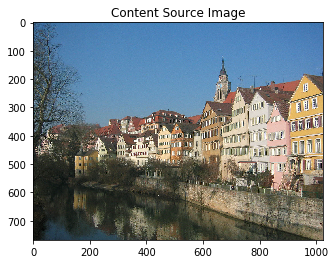

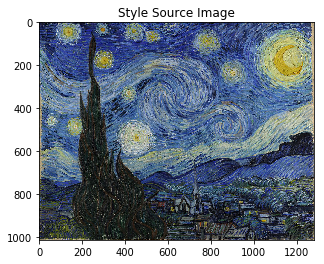

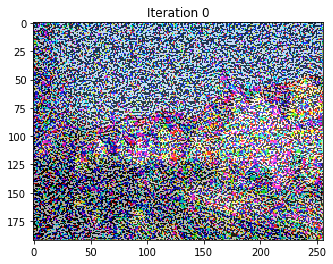

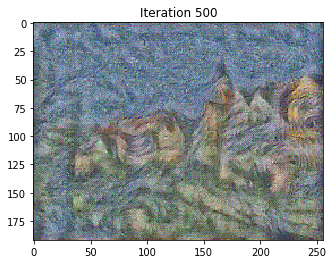

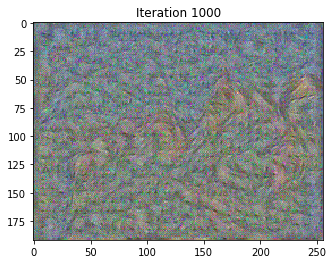

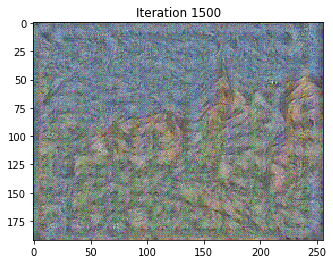

In [ ]:

bridge_starry = style_transfer('/content/bridge.jpg', '/style/starry_night_full.jpg', 6e-2, [300000, 1000, 15, 3], 2e-2, 2000)



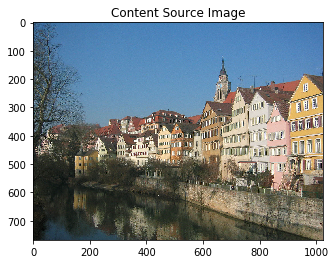

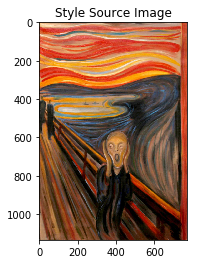

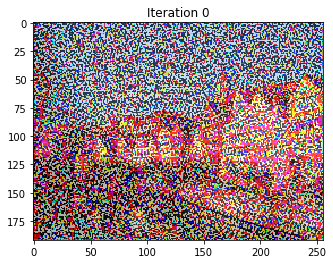

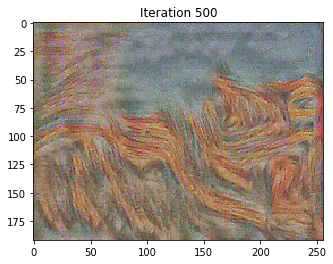

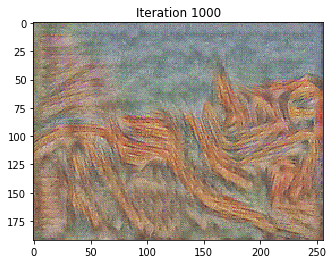

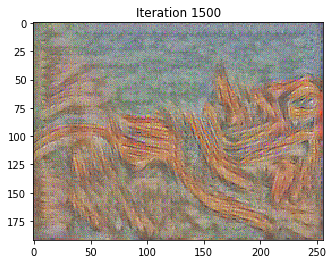

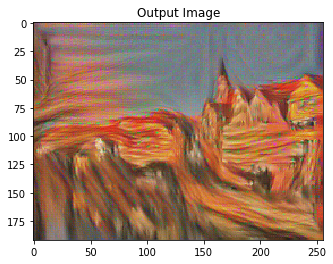

In [22]:

bridge_scream = style_transfer('/content/bridge.jpg', '/style/scream.jpg', 6e-2, [300000, 1000, 15, 3], 2e-2, 2000)


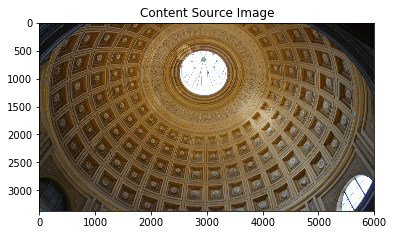

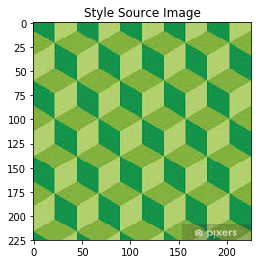

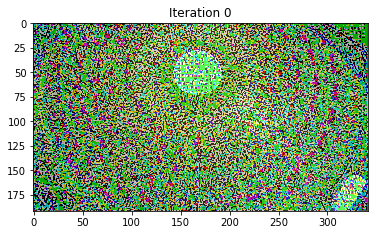

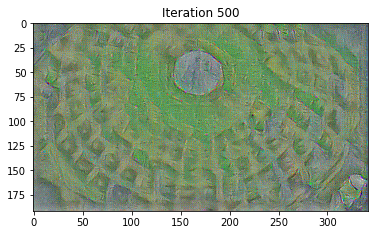

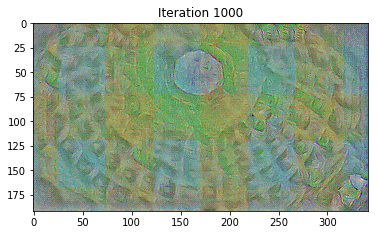

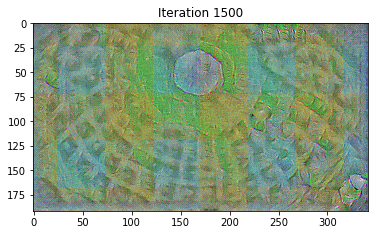

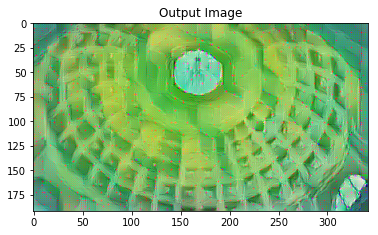

In [41]:

output_square = style_transfer('/content/rome1.jpg', '/style/abstract.JPG', 6e-2, [300000, 1000, 15, 3], 2e-2, 2000)


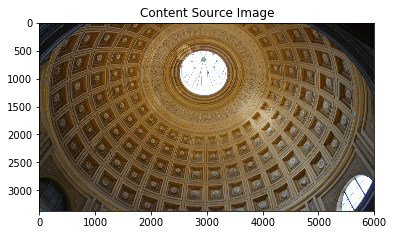

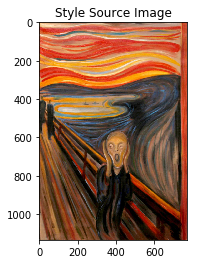

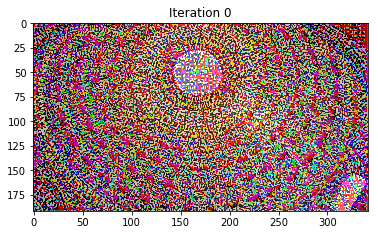

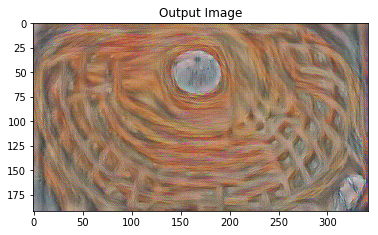

In [16]:


ceiling_scream = style_transfer('content/rome1.jpg', '/style/scream.jpg', 6e-2, [300000, 1000, 15, 3], 2e-2, 2000)



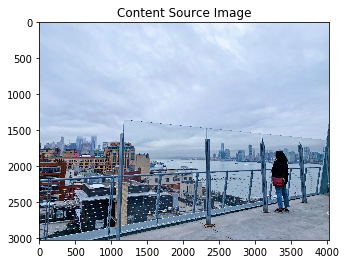

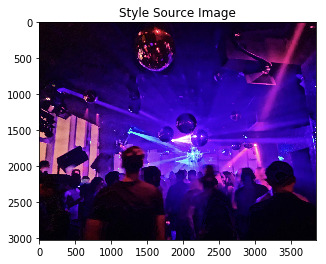

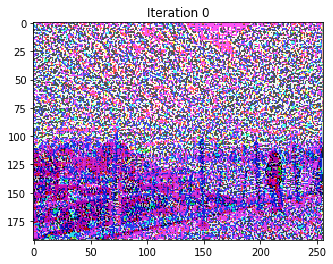

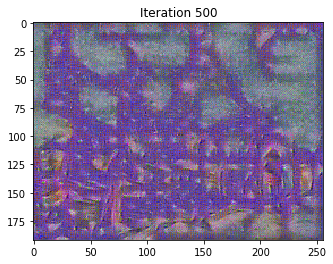

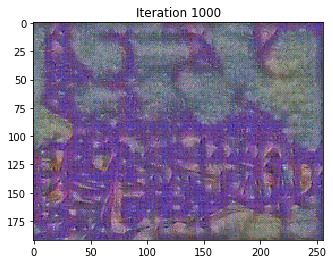

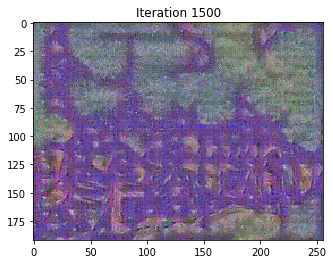

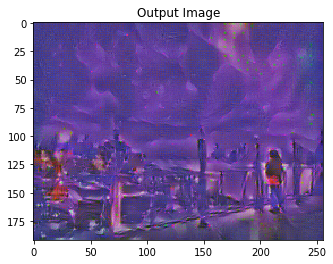

In [141]:


output_scream = style_transfer('/content/musview.jpg', '/style/disco.jpg', 6e-2, [300000, 1000, 15, 3], 2e-2, 2000)



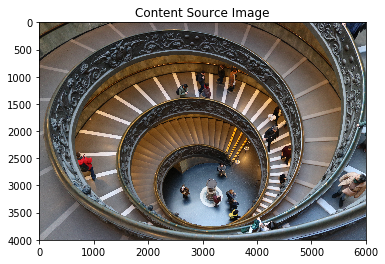

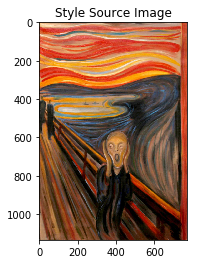

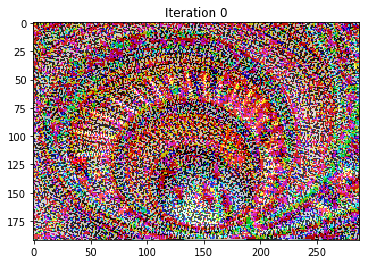

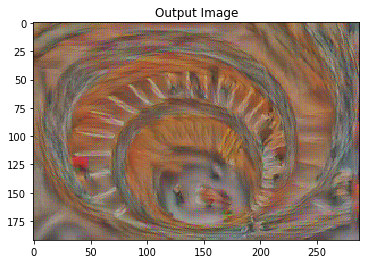

In [15]:


stairs_scream = style_transfer('/content/rome2.jpg', '/style/scream.jpg', 6e-2, [300000, 1000, 15, 3], 2e-2, 2000)



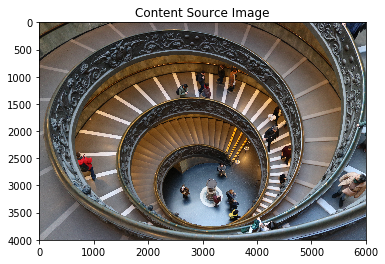

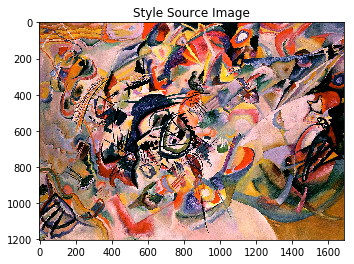

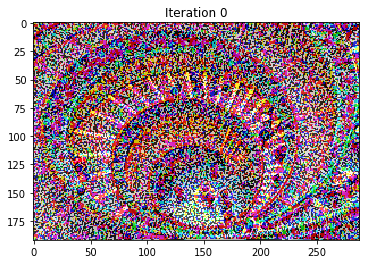

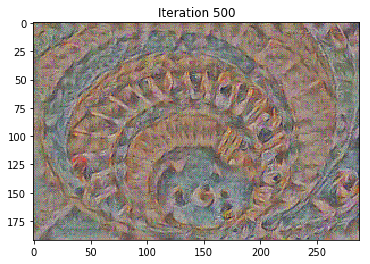

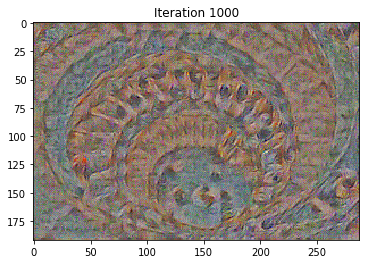

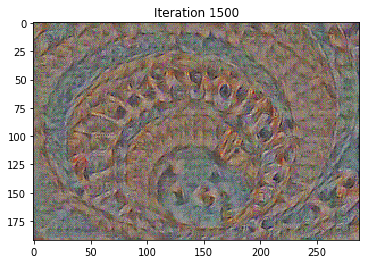

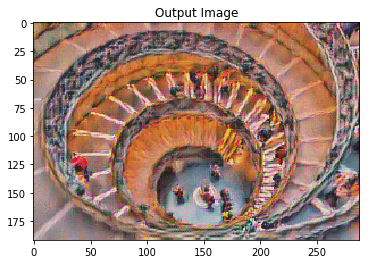

In [52]:


stairs_art = style_transfer('/content/rome2.jpg', '/style/abstract.JPG', 6e-2, [300000, 1000, 15, 3], 2e-2, 2000)




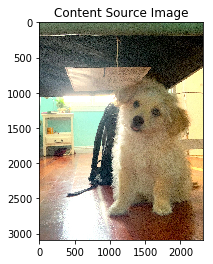

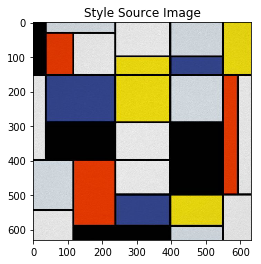

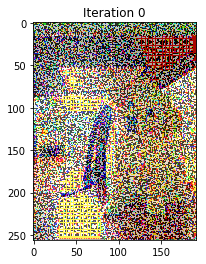

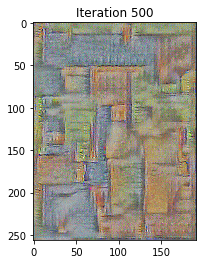

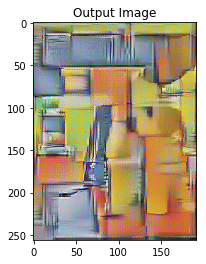

In [53]:


rio_tile = style_transfer('/content/rio.jpeg', '/style/tiles.jpg', 6e-2, [300000, 1000, 15, 3], 2e-2, 1000)



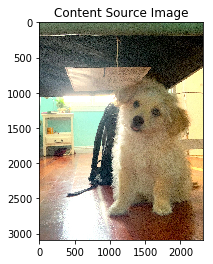

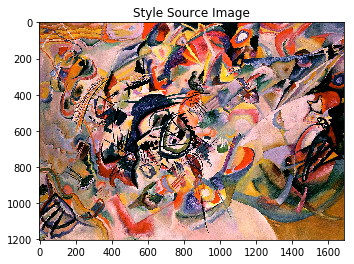

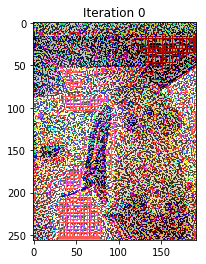

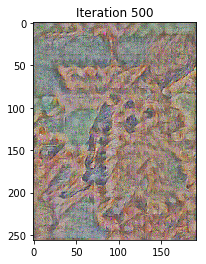

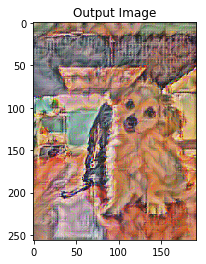

In [54]:


rio_abstract = style_transfer('/content/rio.jpeg', '/style/abstract.jpg', 6e-2, [300000, 1000, 15, 3], 2e-2, 1000)



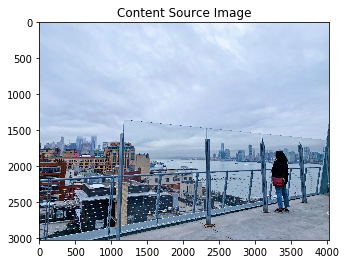

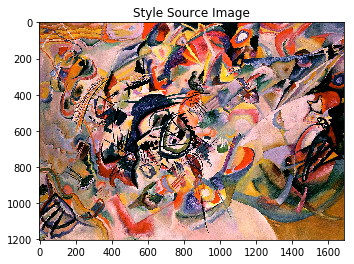

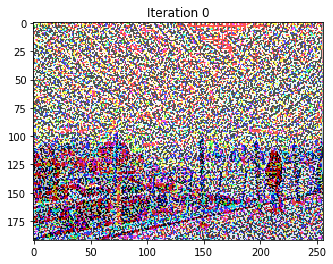

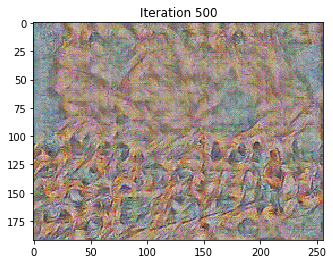

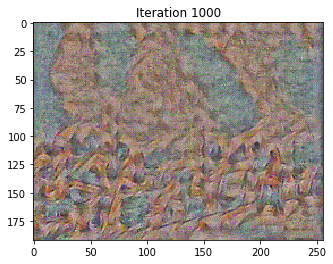

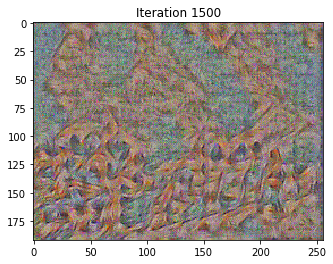

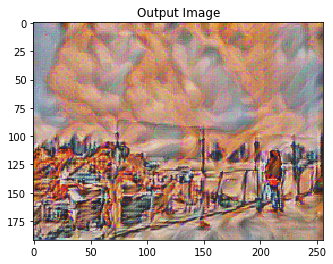

In [51]:


shipwreck_mus = style_transfer('/content/musview.jpg', '/style/abstract.JPG', 6e-2, [300000, 1000, 15, 3], 2e-2, 2000)



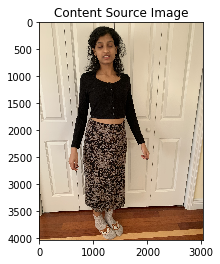

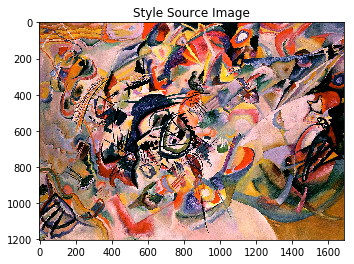

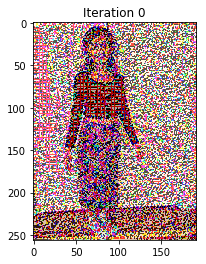

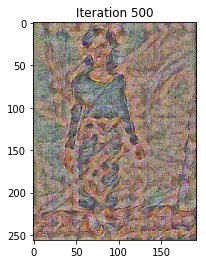

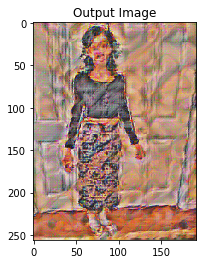

In [59]:


scream_me = style_transfer('/content/me.jpg', '/style/abstract.JPG', 6e-2, [300000, 1000, 15, 3], 2e-2, 1000)



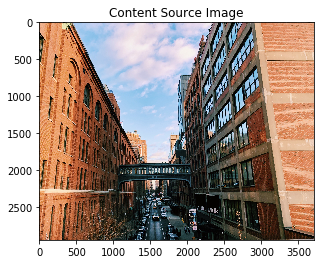

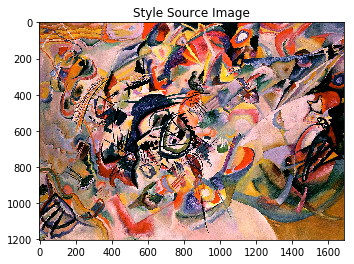

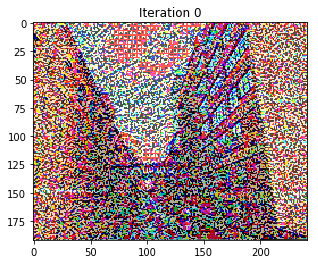

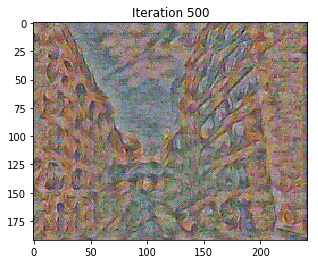

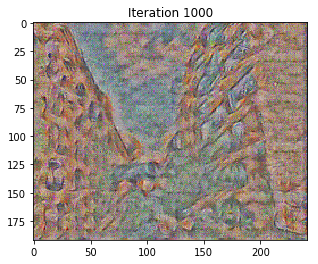

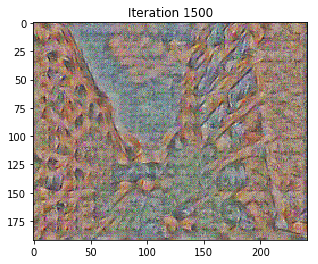

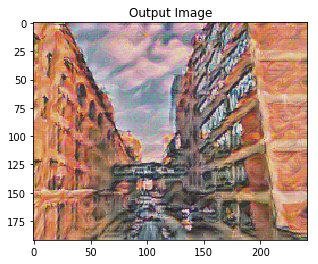

In [37]:


starry_brick = style_transfer('/content/brick.jpg', '/style/abstract.jpg', 6e-2, [300000, 1000, 15, 3], 2e-2, 2000)



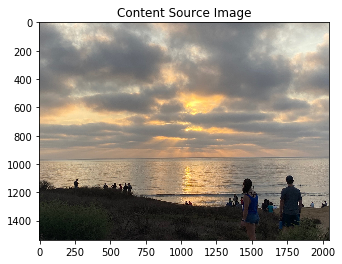

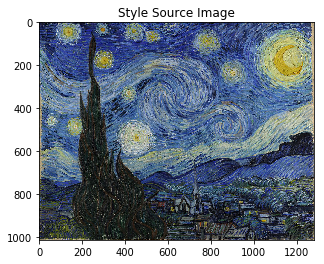

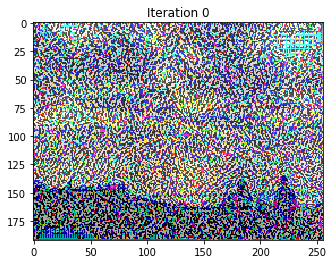

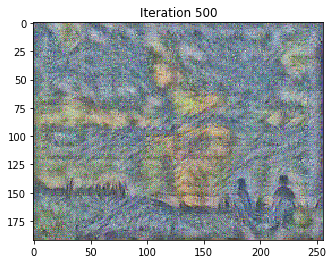

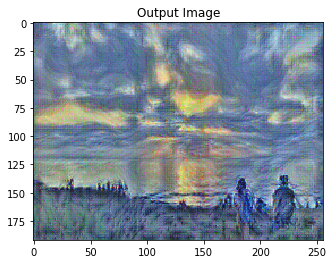

In [21]:


sd_starry = style_transfer('/content/sd2.jpeg', '/style/starry_night_full.jpg', 6e-2, [300000, 1000, 15, 3], 2e-2, 2000)



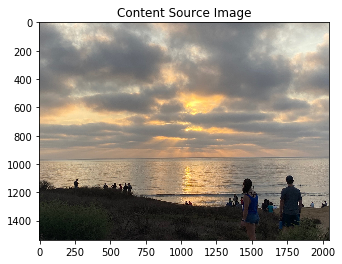

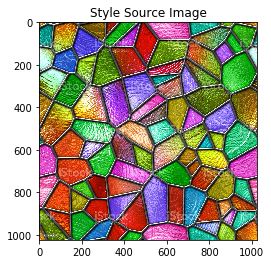

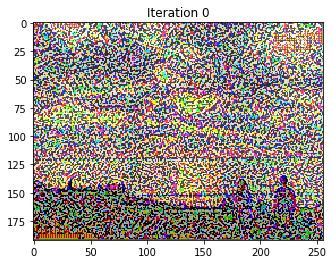

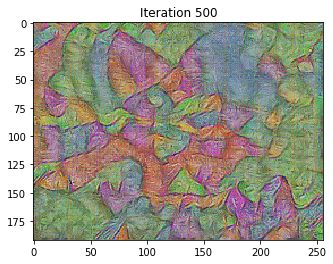

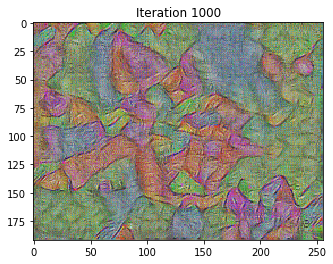

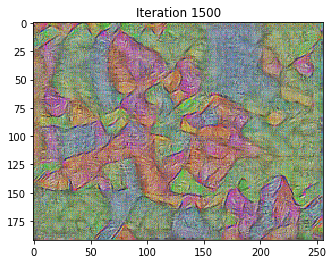

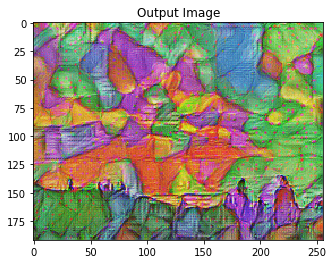

In [64]:


sd_stained = style_transfer('/content/sd2.jpeg', '/style/stainedglass2.jpg', 6e-2, [300000, 1000, 15, 3], 2e-2, 2000)



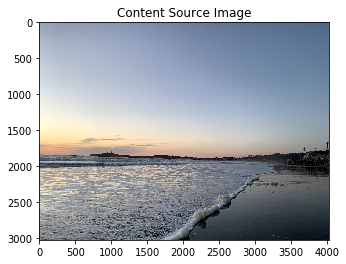

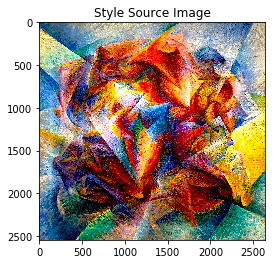

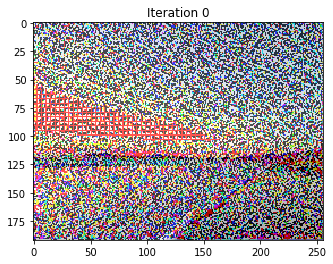

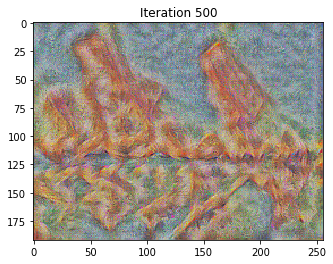

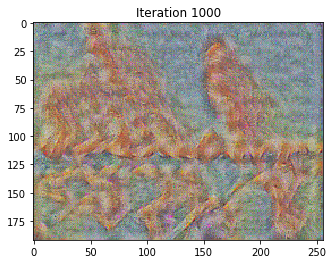

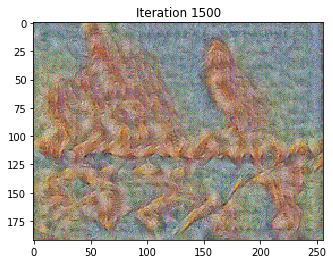

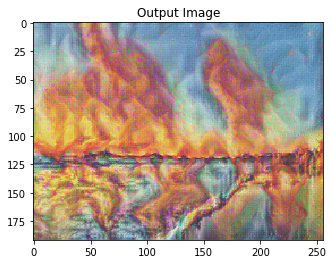

In [27]:


hb_stained = style_transfer('/content/hb1.jpg', '/style/nycpaint.jpg', 6e-2, [300000, 1000, 15, 3], 2e-2, 2000)



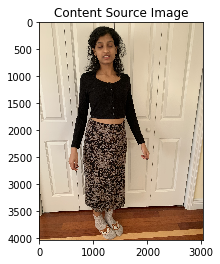

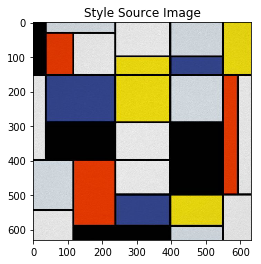

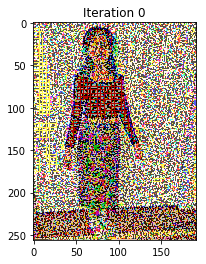

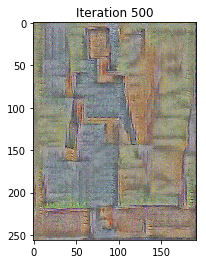

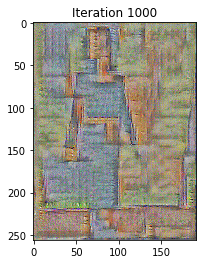

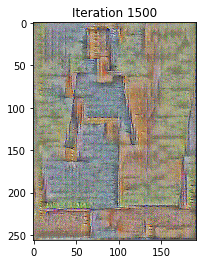

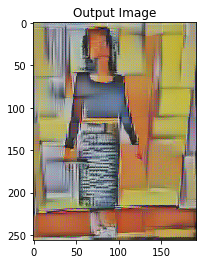

In [28]:


me_tile = style_transfer('/content/me.jpg', '/style/tiles.jpg', 6e-2, [300000, 1000, 15, 3], 2e-2, 2000)



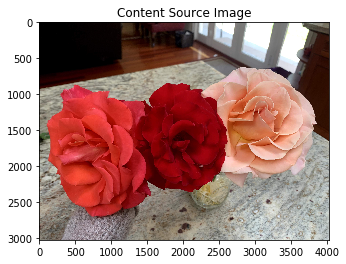

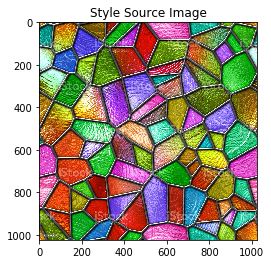

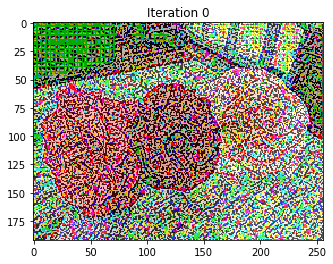

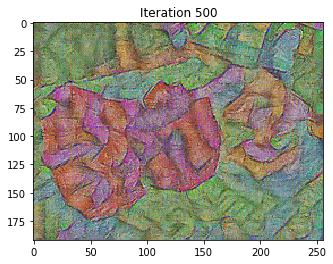

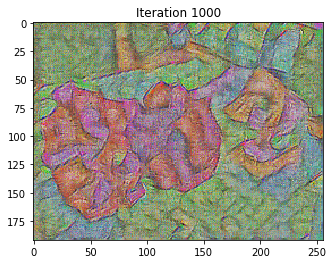

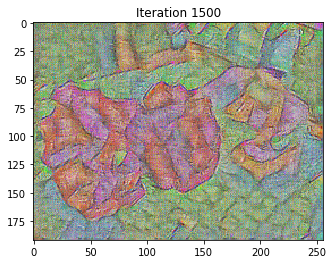

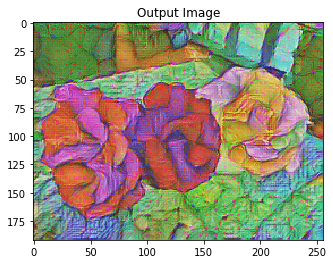

In [30]:


rose_stained = style_transfer('/content/rose.jpg', '/style/stainedglass2.jpg', 6e-2, [300000, 1000, 15, 3], 2e-2, 2000)



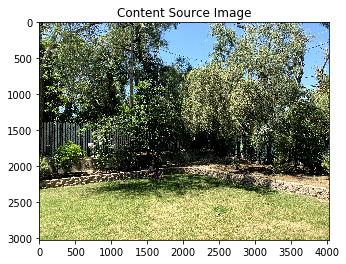

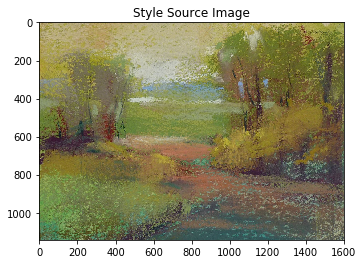

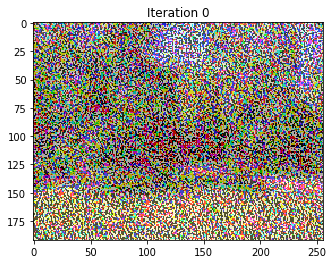

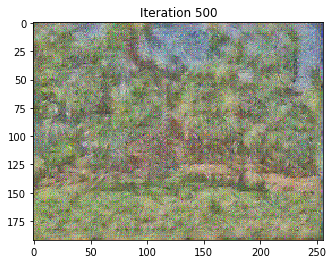

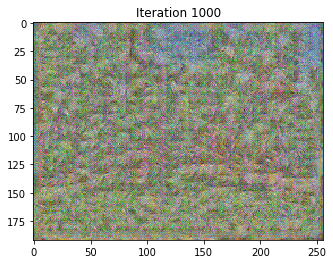

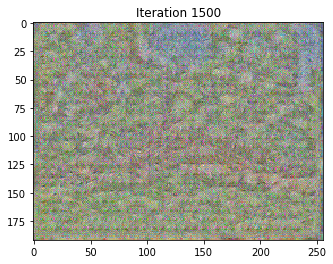

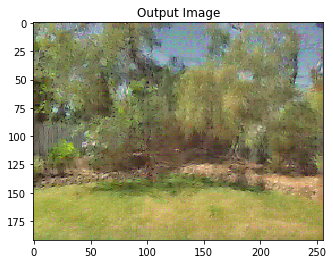

In [31]:


back_circle = style_transfer('/content/backyard.jpg', '/style/painterly.jpg', 6e-2, [300000, 1000, 15, 3], 2e-2, 2000)



In [78]:
output_starry.save("output/output_starry.png")

NameError: name 'output_starry' is not defined